In [2]:
#Import libraries
import pandas as pd
import numpy as np

# load packages
import scipy.stats as stats
import os
from statsmodels.formula.api import ols
import statsmodels.api as sm

import statsmodels.stats.multicomp
from statsmodels.graphics.api import interaction_plot, abline_plot

from statsmodels.formula.api import ols
from statsmodels.stats.anova import anova_lm
import matplotlib.pyplot as plt
from scipy import stats
import seaborn as sns
import random
import math
import statistics 

os.getcwd()
os.chdir('C:\Lecture10')
# os.chdir('C:\Ipsita-AI-2023\ANOVA-Test-COVID-19')


In [3]:
####Load Data
individualDetails=pd.read_csv('./individualDetails.csv',parse_dates=[2])
stateDensity=pd.read_csv('./stateDensity.csv')


C:\Users\Zahid\AppData\Local\Temp\ipykernel_8096\3803505173.py:2: UserWarning: Parsing dates in %d-%m-%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.
  individualDetails=pd.read_csv('./individualDetails.csv',parse_dates=[2])


In [4]:
individualDetails.head()

,id,government_id,diagnosed_date,age,gender,detected_city,detected_district,State,nationality,current_status,status_change_date,notes
0,0,KL-TS-P1,2020-01-30,20,F,Thrissur,Thrissur,Kerala,India,Recovered,14-02-2020,Travelled from Wuhan
1,1,KL-AL-P1,2020-02-02,NaN,NaN,Alappuzha,Alappuzha,Kerala,India,Recovered,14-02-2020,Travelled from Wuhan
2,2,KL-KS-P1,2020-02-03,NaN,NaN,Kasaragod,Kasaragod,Kerala,India,Recovered,14-02-2020,Travelled from Wuhan
3,3,DL-P1,2020-03-02,45,M,East Delhi (Mayur Vihar),East Delhi,Delhi,India,Recovered,15-03-2020,"Travelled from Austria, Italy"
4,4,TS-P1,2020-03-02,24,M,Hyderabad,Hyderabad,Telangana,India,Recovered,02-03-2020,"Travelled from Dubai to Bangalore on 20th Feb,..."


In [5]:
individualDetails[individualDetails['age']==0].shape # There's nobody with age=0

(0, 12)

In [6]:
individualDetails.dtypes

id                             int64
government_id                 object
diagnosed_date        datetime64[ns]
age                           object
gender                        object
detected_city                 object
detected_district             object
State                         object
nationality                   object
current_status                object
status_change_date            object
notes                         object
dtype: object

In [7]:
# Transform data in legit format
for index , row in individualDetails.iterrows():
    if not pd.isnull(row['age']):
        if len(row['age'].split('-'))>1:
                    individualDetails['age'][index]=round((int(row['age'].split('-')[0])+int(row['age'].split('-')[1]))/2)
        elif len(row['age'].split('.'))>1:    
            individualDetails['age'][index]=round(float(row['age']))
        else:
            pass

C:\Users\Zahid\AppData\Local\Temp\ipykernel_8096\3647953014.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  individualDetails['age'][index]=round((int(row['age'].split('-')[0])+int(row['age'].split('-')[1]))/2)
C:\Users\Zahid\AppData\Local\Temp\ipykernel_8096\3647953014.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  individualDetails['age'][index]=round((int(row['age'].split('-')[0])+int(row['age'].split('-')[1]))/2)
C:\Users\Zahid\AppData\Local\Temp\ipykernel_8096\3647953014.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: 

In [8]:
#Check for missing values
individualDetails.isna().sum()

id                        0
government_id         24893
diagnosed_date            0
age                   25544
gender                22577
detected_city         25544
detected_district      7650
State                     0
nationality           25183
current_status            0
status_change_date      110
notes                  1335
dtype: int64

In [9]:
print('Percentage of missing values in age & gender columns respectively :', \
      (individualDetails['age'].isna().sum()/individualDetails.shape[0])*100,'%',\
      (individualDetails['gender'].isna().sum()/individualDetails.shape[0])*100,'%')

Percentage of missing values in age & gender columns respectively : 91.58838293295088 % 80.95016134815346 %


In [10]:
25544/individualDetails.shape[0]

0.9158838293295087

In [207]:
#We see that there're 25544 missing entires in age column i.e.almost 92% of overall Data Size. So in lieu of imputing
#missing values with median or Mode , I'll impute it with mean. 


In [11]:
ageMedianPerState=individualDetails[~individualDetails['age'].isna()]
ageMedianPerState['age']=ageMedianPerState['age'].astype(str).astype(int)

ageMedianPerState=ageMedianPerState.groupby('State')[['age']].median().reset_index()
ageMedianPerState['age']=ageMedianPerState['age'].apply(lambda x:math.ceil(x))

#Find the most frequent infected gender by COVID-19 for each state
genderModePerState=individualDetails.groupby(['State'])['gender'].agg(pd.Series.mode).to_frame().reset_index()
#Drop Arunachal Pradesh , Since this has got no informatio about gender overall
genderModePerState=genderModePerState[genderModePerState['State']!='Arunachal Pradesh']

C:\Users\Zahid\AppData\Local\Temp\ipykernel_8096\2977167924.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ageMedianPerState['age']=ageMedianPerState['age'].astype(str).astype(int)


In [12]:
ageMedianPerState.head()


,State,age
0,Andaman and Nicobar Islands,53
1,Andhra Pradesh,37
2,Assam,52
3,Bihar,31
4,Chandigarh,26


In [13]:
genderModePerState.head()

,State,gender
0,Andaman and Nicobar Islands,M
1,Andhra Pradesh,M
3,Assam,M
4,Bihar,M
5,Chandigarh,M


In [14]:
#Impute missing values in age & gender columns now
for index,row in individualDetails.iterrows():
    if row['State']=='Arunachal Pradesh':     
        individualDetails.drop([index],inplace=True)
        continue
    if pd.isnull(row['age']):
        individualDetails['age'][index]=list(ageMedianPerState['age'][ageMedianPerState['State']=='West Bengal'].values)[0]
    if pd.isnull(row['gender']):
        if len(genderModePerState['gender'][genderModePerState['State']==row['State']].values)>0:
            individualDetails['gender'][index]=(genderModePerState['gender'][genderModePerState['State']==row['State']].values[0])
    

C:\Users\Zahid\AppData\Local\Temp\ipykernel_8096\2829869265.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  individualDetails['age'][index]=list(ageMedianPerState['age'][ageMedianPerState['State']=='West Bengal'].values)[0]
C:\Users\Zahid\AppData\Local\Temp\ipykernel_8096\2829869265.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  individualDetails['gender'][index]=(genderModePerState['gender'][genderModePerState['State']==row['State']].values[0])
C:\Users\Zahid\AppData\Local\Temp\ipykernel_8096\2829869265.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the 

In [15]:
individualDetails.isna().sum()

id                        0
government_id         24892
diagnosed_date            0
age                       0
gender                    0
detected_city         25543
detected_district      7650
State                     0
nationality           25183
current_status            0
status_change_date      110
notes                  1335
dtype: int64

In [16]:
#Merge individualDetails & stateDensity dataframes
data=pd.merge(individualDetails,stateDensity,on='State',how='left').reset_index(drop=True)


In [17]:
data.head() # we see that there're NAs in density group coumn for Telangana & Manipur

,id,government_id,diagnosed_date,age,gender,detected_city,detected_district,State,nationality,current_status,status_change_date,notes,density_Group
0,0,KL-TS-P1,2020-01-30,20,F,Thrissur,Thrissur,Kerala,India,Recovered,14-02-2020,Travelled from Wuhan,Dense3
1,1,KL-AL-P1,2020-02-02,50,M,Alappuzha,Alappuzha,Kerala,India,Recovered,14-02-2020,Travelled from Wuhan,Dense3
2,2,KL-KS-P1,2020-02-03,50,M,Kasaragod,Kasaragod,Kerala,India,Recovered,14-02-2020,Travelled from Wuhan,Dense3
3,3,DL-P1,2020-03-02,45,M,East Delhi (Mayur Vihar),East Delhi,Delhi,India,Recovered,15-03-2020,"Travelled from Austria, Italy",Dense4
4,4,TS-P1,2020-03-02,24,M,Hyderabad,Hyderabad,Telangana,India,Recovered,02-03-2020,"Travelled from Dubai to Bangalore on 20th Feb,...",NaN


In [18]:
data.shape

(27889, 13)

In [19]:
data['State'].unique()

array(['Kerala', 'Delhi', 'Telangana', 'Rajasthan', 'Haryana',
       'Uttar Pradesh', 'Ladakh', 'Tamil Nadu', 'Jammu and Kashmir',
       'Karnataka', 'Maharashtra', 'Punjab', 'Andhra Pradesh',
       'Uttarakhand', 'Odisha', 'Puducherry', 'West Bengal', 'Chandigarh',
       'Chhattisgarh', 'Gujarat', 'Himachal Pradesh', 'Madhya Pradesh',
       'Bihar', 'Manipur', 'Mizoram', 'Goa',
       'Andaman and Nicobar Islands', 'Jharkhand', 'Assam', 'Tripura',
       'Meghalaya'], dtype=object)

In [193]:
# data[data['State']=='Telangana']

In [20]:
data.dropna(subset=['density_Group'],inplace=True) #Drop Telangana & Manipur.

In [21]:
data.reset_index(drop=True,inplace=True) #resetting index , since just now we've dropped few records

In [22]:
#create Age Group bucket
data['age_Group']=0
for index, row in data.iterrows():
    i=float(row['age'])
    if 0<i<=20:
        data['age_Group'][index]='Young'
    elif 20<i<=40:
        data['age_Group'][index]='Adult'
    else:
        data['age_Group'][index]='Old'

C:\Users\Zahid\AppData\Local\Temp\ipykernel_8096\2356449829.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['age_Group'][index]='Young'


In [23]:
data.head()

,id,government_id,diagnosed_date,age,gender,detected_city,detected_district,State,nationality,current_status,status_change_date,notes,density_Group,age_Group
0,0,KL-TS-P1,2020-01-30,20,F,Thrissur,Thrissur,Kerala,India,Recovered,14-02-2020,Travelled from Wuhan,Dense3,Young
1,1,KL-AL-P1,2020-02-02,50,M,Alappuzha,Alappuzha,Kerala,India,Recovered,14-02-2020,Travelled from Wuhan,Dense3,Old
2,2,KL-KS-P1,2020-02-03,50,M,Kasaragod,Kasaragod,Kerala,India,Recovered,14-02-2020,Travelled from Wuhan,Dense3,Old
3,3,DL-P1,2020-03-02,45,M,East Delhi (Mayur Vihar),East Delhi,Delhi,India,Recovered,15-03-2020,"Travelled from Austria, Italy",Dense4,Old
4,5,NaN,2020-03-03,69,M,Jaipur,Italians*,Rajasthan,Italy,Recovered,03-03-2020,Travelled from Italy,Dense1,Old


In [24]:
data[data['age_Group']==0]

,id,government_id,diagnosed_date,age,gender,detected_city,detected_district,State,nationality,current_status,status_change_date,notes,density_Group,age_Group


In [25]:
## Merge the data to get dataset with each person mapped with their age group and their respective state density group
patient_Count=data.groupby(['diagnosed_date','density_Group'])[['diagnosed_date']].count().\
                        rename(columns={'diagnosed_date':'Count'}).reset_index()
data=pd.merge(data,patient_Count,on=['diagnosed_date','density_Group'],how='inner')
data.head()

,id,government_id,diagnosed_date,age,gender,detected_city,detected_district,State,nationality,current_status,status_change_date,notes,density_Group,age_Group,Count
0,0,KL-TS-P1,2020-01-30,20,F,Thrissur,Thrissur,Kerala,India,Recovered,14-02-2020,Travelled from Wuhan,Dense3,Young,1
1,1,KL-AL-P1,2020-02-02,50,M,Alappuzha,Alappuzha,Kerala,India,Recovered,14-02-2020,Travelled from Wuhan,Dense3,Old,1
2,2,KL-KS-P1,2020-02-03,50,M,Kasaragod,Kasaragod,Kerala,India,Recovered,14-02-2020,Travelled from Wuhan,Dense3,Old,1
3,3,DL-P1,2020-03-02,45,M,East Delhi (Mayur Vihar),East Delhi,Delhi,India,Recovered,15-03-2020,"Travelled from Austria, Italy",Dense4,Old,1
4,5,NaN,2020-03-03,69,M,Jaipur,Italians*,Rajasthan,Italy,Recovered,03-03-2020,Travelled from Italy,Dense1,Old,1


In [26]:
#Rearrange Dataframe
newData=data.groupby(['density_Group','age_Group'])['Count'].apply(list).reset_index()
print(newData)

   density_Group age_Group                                              Count
0         Dense1     Adult  [1, 2, 5, 4, 4, 6, 16, 16, 16, 7, 7, 23, 23, 2...
1         Dense1       Old  [1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 5, 5, 5, 5, 4, ...
2         Dense1     Young  [4, 6, 18, 18, 27, 27, 32, 11, 41, 84, 191, 19...
3         Dense2     Adult  [6, 5, 5, 5, 5, 9, 6, 8, 7, 7, 7, 10, 10, 10, ...
4         Dense2       Old  [14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 1...
5         Dense2     Young  [6, 6, 8, 7, 10, 12, 12, 41, 47, 43, 43, 43, 5...
6         Dense3     Adult  [5, 4, 2, 2, 2, 16, 16, 16, 16, 16, 17, 17, 17...
7         Dense3       Old  [1, 1, 7, 7, 7, 7, 7, 7, 1, 5, 5, 5, 5, 3, 3, ...
8         Dense3     Young  [1, 7, 3, 16, 16, 16, 22, 22, 27, 37, 37, 37, ...
9         Dense4     Adult  [1, 1, 1, 4, 4, 4, 4, 11, 11, 11, 9, 9, 9, 7, ...
10        Dense4       Old  [1, 1, 1, 1, 1, 5, 5, 5, 5, 11, 11, 11, 11, 11...
11        Dense4     Young  [5, 7, 8, 8, 9, 9, 9, 165, 68, 68, 6

In [27]:
newData.head()

,density_Group,age_Group,Count
0,Dense1,Adult,"[1, 2, 5, 4, 4, 6, 16, 16, 16, 7, 7, 23, 23, 2..."
1,Dense1,Old,"[1, 1, 2, 2, 1, 1, 1, 1, 1, 2, 5, 5, 5, 5, 4, ..."
2,Dense1,Young,"[4, 6, 18, 18, 27, 27, 32, 11, 41, 84, 191, 19..."
3,Dense2,Adult,"[6, 5, 5, 5, 5, 9, 6, 8, 7, 7, 7, 10, 10, 10, ..."
4,Dense2,Old,"[14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 1..."


In [28]:
newData.shape

(12, 3)

In [29]:
#Select random samples of each category
np.random.seed(1234)
AnovaData=pd.DataFrame(columns=['density_Group','age_Group','Count'])
for index,row in newData.iterrows():
    count=17
    tempDf=pd.DataFrame(index=range(0,count),columns=['density_Group','age_Group','Count'])
    
    tempDf['age_Group']=newData['age_Group'][index]
    tempDf['density_Group']=newData['density_Group'][index]
    tempDf['Count']=random.sample(list(newData['Count'][index]),count)
    AnovaData=pd.concat([AnovaData,tempDf],axis=0)
    print(AnovaData)
    
    

   density_Group age_Group Count
0         Dense1     Adult     4
1         Dense1     Adult   174
2         Dense1     Adult    16
3         Dense1     Adult    32
4         Dense1     Adult    32
5         Dense1     Adult   245
6         Dense1     Adult     7
7         Dense1     Adult     6
8         Dense1     Adult    16
9         Dense1     Adult   245
10        Dense1     Adult    32
11        Dense1     Adult    27
12        Dense1     Adult   262
13        Dense1     Adult    32
14        Dense1     Adult   206
15        Dense1     Adult    11
16        Dense1     Adult    32
   density_Group age_Group Count
0         Dense1     Adult     4
1         Dense1     Adult   174
2         Dense1     Adult    16
3         Dense1     Adult    32
4         Dense1     Adult    32
5         Dense1     Adult   245
6         Dense1     Adult     7
7         Dense1     Adult     6
8         Dense1     Adult    16
9         Dense1     Adult   245
10        Dense1     Adult    32
11        

In [30]:
AnovaData.to_csv('AnovaData.csv',index=False)

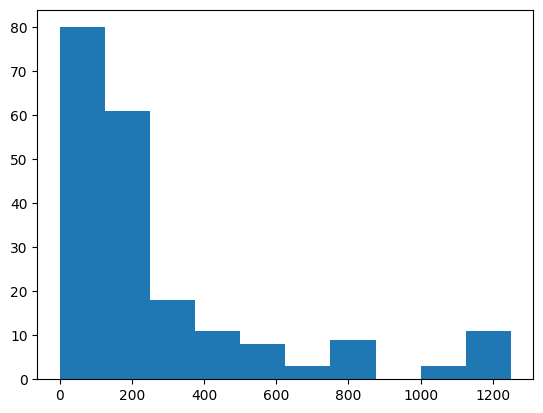

C:\Users\Zahid\AppData\Local\Temp\ipykernel_8096\1733866563.py:3: UserWarning: 

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`.
Setting `bw_method=2`, but please see the docs for the new parameters
and update your code. This will become an error in seaborn v0.13.0.

  sns.kdeplot(AnovaData['Count'],cumulative=False,bw=2)


<Axes: xlabel='Count', ylabel='Density'>

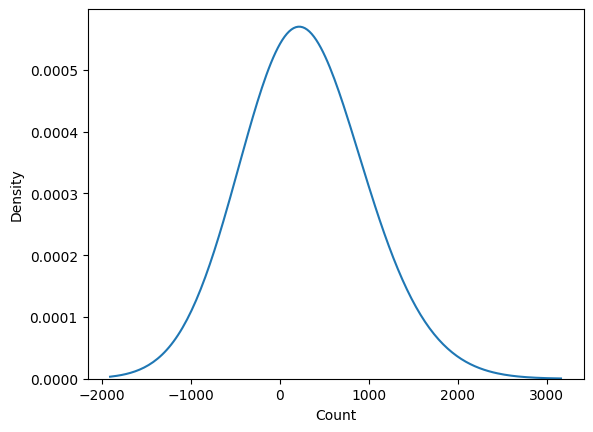

In [31]:
plt.hist(AnovaData['Count'])
plt.show()
sns.kdeplot(AnovaData['Count'],cumulative=False,bw=2)

In [143]:
# AnovaData['Count']=AnovaData['Count']+1

In [32]:
AnovaData.dtypes

density_Group    object
age_Group        object
Count            object
dtype: object

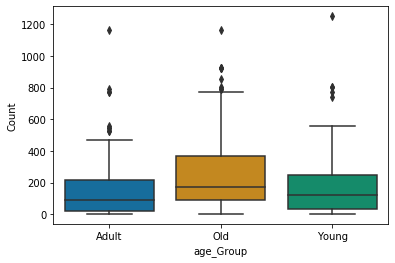

In [233]:
#Check for outliers
sns.boxplot(x='age_Group', y='Count', 
                 data=AnovaData, 
                 palette="colorblind")


In [33]:
AnovaData['Count']=AnovaData['Count'].astype(int)

In [34]:
# Data Transformation
AnovaData['newCount'],fitted_lambda = stats.boxcox(AnovaData['Count'])

C:\Users\Zahid\AppData\Local\Temp\ipykernel_8096\1558458221.py:2: UserWarning: 

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`.
Setting `bw_method=2`, but please see the docs for the new parameters
and update your code. This will become an error in seaborn v0.13.0.

  sns.kdeplot(AnovaData['newCount'],cumulative=False,bw=2)


<Axes: xlabel='newCount', ylabel='Density'>

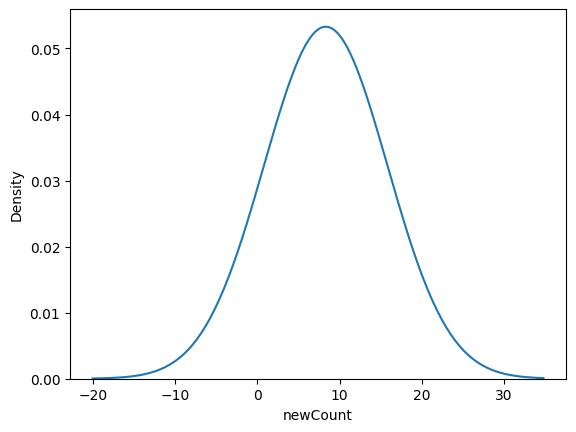

In [35]:
import matplotlib.pyplot as plt
sns.kdeplot(AnovaData['newCount'],cumulative=False,bw=2)

In [36]:
AnovaData.head()

,density_Group,age_Group,Count,newCount
0,Dense1,Adult,4,1.578925
1,Dense1,Adult,174,8.602752
2,Dense1,Adult,16,3.616084
3,Dense1,Adult,32,4.846669
4,Dense1,Adult,32,4.846669


In [37]:
AnovaData.shape

(204, 4)

In [38]:
AnovaData.isna().sum()

density_Group    0
age_Group        0
Count            0
newCount         0
dtype: int64

In [39]:
# Fit the OlS model
#Approach 1.
model2 = ols('newCount ~ C(age_Group)+ C(density_Group)', AnovaData).fit()

print(f"Overall model F({model2.df_model: },{model2.df_resid: }) = {model2.fvalue: }, p = {model2.f_pvalue: }")
model2.summary()

Overall model F( 5.0, 198.0) =  53.960443613635, p =  3.613449900464206e-35


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               newCount   R-squared:                       0.577
Model:                            OLS   Adj. R-squared:                  0.566
Method:                 Least Squares   F-statistic:                     53.96
Date:                Tue, 13 Jun 2023   Prob (F-statistic):           3.61e-35
Time:                        13:54:33   Log-Likelihood:                -447.35
No. Observations:                 204   AIC:                             906.7
Df Residuals:                     198   BIC:                             926.6
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================================
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Intercept                      6.0899      0.377     16.134      0.000       5.346       6.834
C(age_Group)[T.Old]            1.9839      0.377      5.256      0.000       1.240       2.728
C(age_Group)[T.Young]          0.4051      0.377      1.073      0.284      -0.339       1.149
C(density_Group)[T.Dense2]     5.3911      0.436     12.370      0.000       4.532       6.251
C(density_Group)[T.Dense3]    -0.7518      0.436     -1.725      0.086      -1.611       0.108
C(density_Group)[T.Dense4]     0.9805      0.436      2.250      0.026       0.121       1.840
==============================================================================
Omnibus:                       22.741   Durbin-Watson:                   2.084
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               29.236
Skew:                          -0.735   Prob(JB):                     4.48e-07
Kurtosis:                       4.131   Cond. No.                         5.35
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [40]:
# Creates the ANOVA table
res2 = sm.stats.anova_lm(model2, typ=2)
res2

,sum_sq,df,F,PR(>F)
C(age_Group),149.431190,2.0,15.424645,5.949033e-07
C(density_Group),1157.466502,3.0,79.650976,7.752870e-34
Residual,959.094202,198.0,NaN,NaN


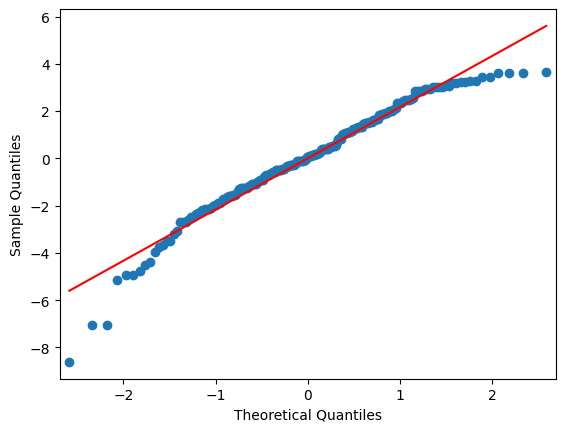

In [41]:
#Check the Normal distribution of residuals
res = model2.resid 
fig = sm.qqplot(res, line='s')
plt.show()

In [158]:
#As we can see that, residuals are almost normally distributed . Although points at the extreme ends can be discounted.

In [42]:
#Approach 2.
formula = 'newCount ~ C(age_Group) *C(density_Group)'
model = ols(formula, AnovaData).fit()

model.summary()



<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               newCount   R-squared:                       0.595
Model:                            OLS   Adj. R-squared:                  0.572
Method:                 Least Squares   F-statistic:                     25.68
Date:                Tue, 13 Jun 2023   Prob (F-statistic):           3.41e-32
Time:                        14:00:22   Log-Likelihood:                -442.75
No. Observations:                 204   AIC:                             909.5
Df Residuals:                     192   BIC:                             949.3
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
====================================================================================================================
                                                       coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------------------
Intercept                                            5.3780      0.530     10.147      0.000       4.333       6.423
C(age_Group)[T.Old]                                  3.7476      0.750      5.000      0.000       2.269       5.226
C(age_Group)[T.Young]                                0.7769      0.750      1.037      0.301      -0.701       2.255
C(density_Group)[T.Dense2]                           6.3634      0.750      8.490      0.000       4.885       7.842
C(density_Group)[T.Dense3]                          -0.0177      0.750     -0.024      0.981      -1.496       1.461
C(density_Group)[T.Dense4]                           2.1215      0.750      2.830      0.005       0.643       3.600
C(age_Group)[T.Old]:C(density_Group)[T.Dense2]      -2.5178      1.060     -2.375      0.019      -4.609      -0.427
C(age_Group)[T.Young]:C(density_Group)[T.Dense2]    -0.3988      1.060     -0.376      0.707      -2.490       1.692
C(age_Group)[T.Old]:C(density_Group)[T.Dense3]      -1.9852      1.060     -1.873      0.063      -4.076       0.106
C(age_Group)[T.Young]:C(density_Group)[T.Dense3]    -0.2173      1.060     -0.205      0.838      -2.308       1.873
C(age_Group)[T.Old]:C(density_Group)[T.Dense4]      -2.5518      1.060     -2.407      0.017      -4.643      -0.461
C(age_Group)[T.Young]:C(density_Group)[T.Dense4]    -0.8712      1.060     -0.822      0.412      -2.962       1.220
==============================================================================
Omnibus:                       29.014   Durbin-Watson:                   2.173
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               48.785
Skew:                          -0.763   Prob(JB):                     2.55e-11
Kurtosis:                       4.847   Cond. No.                         17.9
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [43]:
aov_table = anova_lm(model, typ=2)
print(aov_table.round(4))

                                  sum_sq     df        F  PR(>F)
C(age_Group)                    149.4312    2.0  15.6461   0.000
C(density_Group)               1157.4665    3.0  80.7948   0.000
C(age_Group):C(density_Group)    42.2298    6.0   1.4739   0.189
Residual                        916.8644  192.0      NaN     NaN


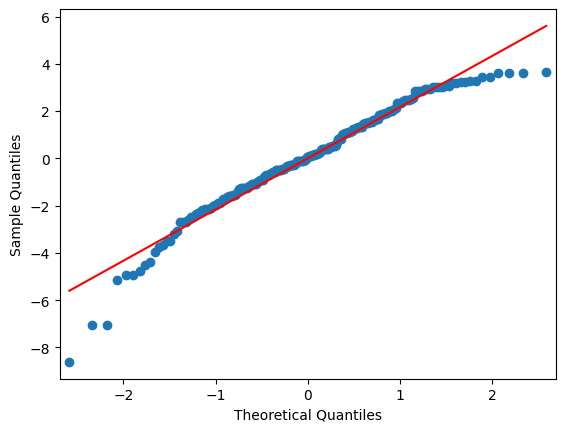

In [44]:
#Check the Normal distribution of residuals
res = model2.resid 
fig = sm.qqplot(res, line='s')
plt.show()

In [46]:
###Approch 3.

formula = 'newCount ~ C(age_Group) + C(density_Group) + C(age_Group):C(density_Group)'
model = ols(formula, AnovaData).fit()

model.summary()



<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               newCount   R-squared:                       0.595
Model:                            OLS   Adj. R-squared:                  0.572
Method:                 Least Squares   F-statistic:                     25.68
Date:                Tue, 13 Jun 2023   Prob (F-statistic):           3.41e-32
Time:                        14:03:35   Log-Likelihood:                -442.75
No. Observations:                 204   AIC:                             909.5
Df Residuals:                     192   BIC:                             949.3
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
====================================================================================================================
                                                       coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------------------
Intercept                                            5.3780      0.530     10.147      0.000       4.333       6.423
C(age_Group)[T.Old]                                  3.7476      0.750      5.000      0.000       2.269       5.226
C(age_Group)[T.Young]                                0.7769      0.750      1.037      0.301      -0.701       2.255
C(density_Group)[T.Dense2]                           6.3634      0.750      8.490      0.000       4.885       7.842
C(density_Group)[T.Dense3]                          -0.0177      0.750     -0.024      0.981      -1.496       1.461
C(density_Group)[T.Dense4]                           2.1215      0.750      2.830      0.005       0.643       3.600
C(age_Group)[T.Old]:C(density_Group)[T.Dense2]      -2.5178      1.060     -2.375      0.019      -4.609      -0.427
C(age_Group)[T.Young]:C(density_Group)[T.Dense2]    -0.3988      1.060     -0.376      0.707      -2.490       1.692
C(age_Group)[T.Old]:C(density_Group)[T.Dense3]      -1.9852      1.060     -1.873      0.063      -4.076       0.106
C(age_Group)[T.Young]:C(density_Group)[T.Dense3]    -0.2173      1.060     -0.205      0.838      -2.308       1.873
C(age_Group)[T.Old]:C(density_Group)[T.Dense4]      -2.5518      1.060     -2.407      0.017      -4.643      -0.461
C(age_Group)[T.Young]:C(density_Group)[T.Dense4]    -0.8712      1.060     -0.822      0.412      -2.962       1.220
==============================================================================
Omnibus:                       29.014   Durbin-Watson:                   2.173
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               48.785
Skew:                          -0.763   Prob(JB):                     2.55e-11
Kurtosis:                       4.847   Cond. No.                         17.9
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [47]:
aov_table = statsmodels.stats.anova.anova_lm(model, typ=2)
print(aov_table)

                                    sum_sq     df          F        PR(>F)
C(age_Group)                    149.431190    2.0  15.646146  5.070369e-07
C(density_Group)               1157.466502    3.0  80.794781  7.609521e-34
C(age_Group):C(density_Group)    42.229834    6.0   1.473887  1.890316e-01
Residual                        916.864368  192.0        NaN           NaN


In [164]:
#Interpretation: The P-value obtained from ANOVA analysis for genotype, years, and interaction are statistically significant 
#(P<0.05). We conclude that type of density_Group significantly affects the corona cases outcome,
#age_Group significantly affects the corona cases outcome outcome, and interaction of both age_Group and density_Group 
#significantly affects the corona cases outcome outcome.

In [48]:
AnovaData.dtypes

density_Group     object
age_Group         object
Count              int32
newCount         float64
dtype: object

In [49]:
AnovaData.head()

,density_Group,age_Group,Count,newCount
0,Dense1,Adult,4,1.578925
1,Dense1,Adult,174,8.602752
2,Dense1,Adult,16,3.616084
3,Dense1,Adult,32,4.846669
4,Dense1,Adult,32,4.846669


In [50]:
#Post hoc test
mc = statsmodels.stats.multicomp.MultiComparison(AnovaData['newCount'],AnovaData['density_Group'])
mc_results = mc.tukeyhsd()
print(mc_results)

Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
Dense1 Dense2   5.3911    0.0  4.1833   6.599   True
Dense1 Dense3  -0.7518 0.3739 -1.9597   0.456  False
Dense1 Dense4   0.9805 0.1556 -0.2273  2.1884  False
Dense2 Dense3   -6.143    0.0 -7.3508 -4.9351   True
Dense2 Dense4  -4.4106    0.0 -5.6185 -3.2028   True
Dense3 Dense4   1.7323 0.0015  0.5245  2.9402   True
----------------------------------------------------


In [51]:
#Post hoc test
mc = statsmodels.stats.multicomp.MultiComparison(AnovaData['newCount'],AnovaData['age_Group'])
mc_results = mc.tukeyhsd()
print(mc_results)

Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
 Adult    Old   1.9839 0.0013  0.6698  3.2979   True
 Adult  Young   0.4051 0.7473  -0.909  1.7191  False
   Old  Young  -1.5788 0.0139 -2.8929 -0.2648   True
----------------------------------------------------
